In [2]:
from glob import glob
import matplotlib.pyplot as plt
import numpy as np

In [3]:
def nonzero_bounding_box(img:np.ndarray, verbose=False):
    '''
    1. split the image into four quadrants: h_left_split, h_right_split, w_top_split, w_bottom_split
    2. find the last non-zero pixel position for left and top splits
    3. find the first non-zero pixel position for right and bottom splits
    return the index of the above 4 values as bounding box (left,top,right,bottom)
    '''
    h,w,c = img.shape

        
    # split image into four quadrants, use the first channel
    left_half_axis_1d = img[h//2,:w//2,0].tolist()
    top_half_axis_1d = img[:h//2,w//2,0].tolist()

    right_half_axis_1d = img[h//2,w//2:,0].tolist()
    bottom_half_axis_1d = img[h//2:,w//2,0].tolist()

    # find first nonzero pixel positions, if no non-zero pixel positions exist, return lower-bounds and upper-bounds
    try:
        h_left = len(left_half_axis_1d) - left_half_axis_1d[::-1].index(0)
    except ValueError as e:
        # could not find zero in the list
        h_left = 0
    
    try:
        w_top = len(top_half_axis_1d) - top_half_axis_1d[::-1].index(0)
    except ValueError as e:
        w_top = 0

    try:
        h_right = w//2 + right_half_axis_1d.index(0)
    except ValueError as e:
        h_right = h
    
    try:
        w_bottom = h//2 + bottom_half_axis_1d.index(0)
    except ValueError as e:
        w_bottom = w

    if verbose:
        print(f'Image size {img.shape}')
        print(h_left,h_right,w_top,w_bottom)
    return h_left,h_right,w_top,w_bottom

def crop_nonzero(img, verbose=False):
    left, right, top, bottom = nonzero_bounding_box(img,verbose=verbose)
    return img[top:bottom,left:right,:]

In [5]:
data_root_dir = 'odir2019/ODIR-5K_Training_Dataset'
img_paths = glob(f'{data_root_dir}/*.jpg')

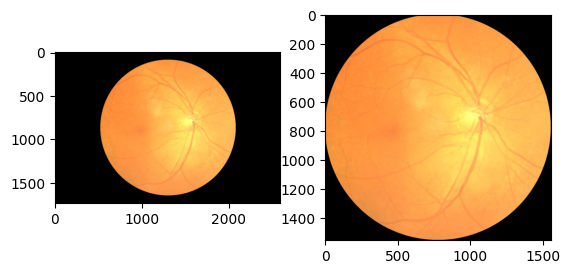

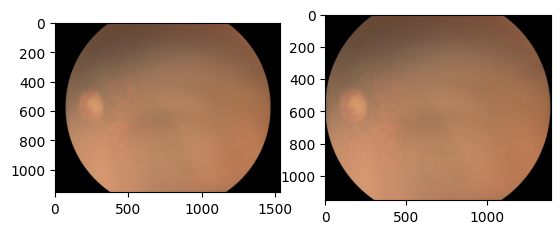

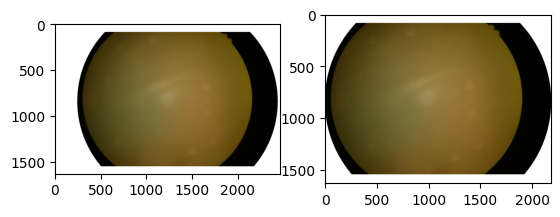

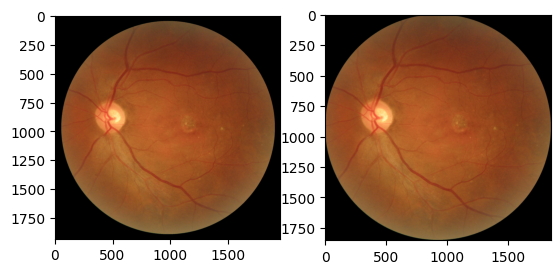

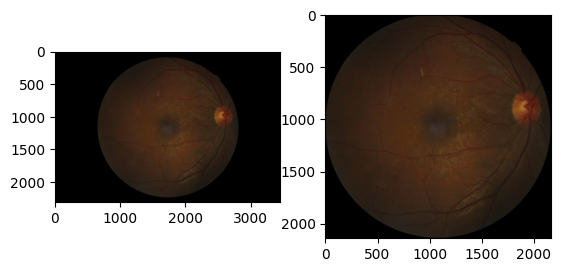

...

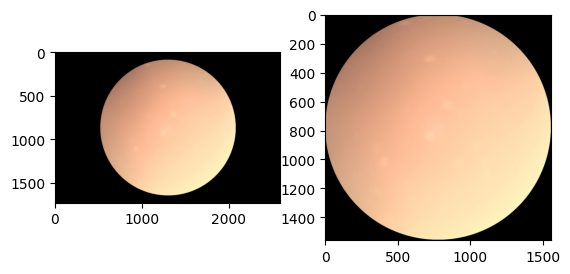

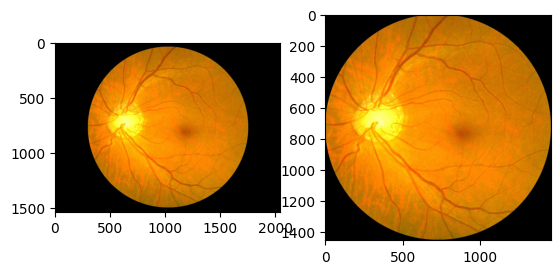

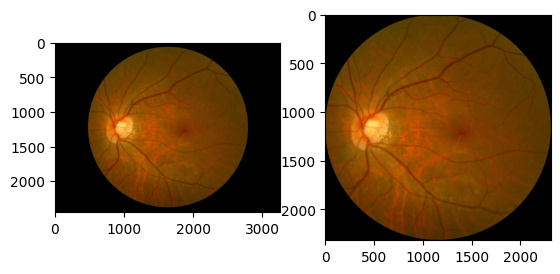

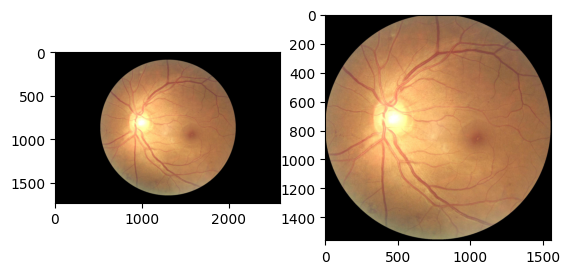

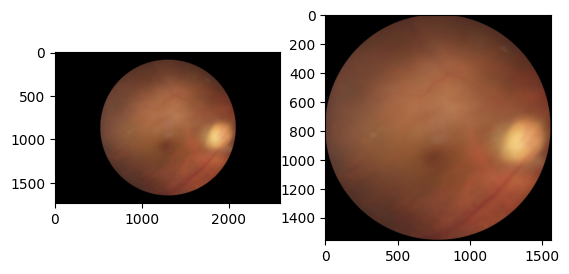

KeyboardInterrupt: 

In [8]:
for i in range(len(img_paths)//10):
    fig,ax = plt.subplots(1,2)
    img = plt.imread(img_paths[i*10])
    cropped_img = crop_nonzero(img)
    ax[0].imshow(img)
    ax[1].imshow(cropped_img)
    plt.show()

In [9]:
from torchvision.transforms import Pad,Lambda, Compose

img_transform = Compose([
    Lambda(plt.imread),
    Lambda(crop_nonzero)
])

import functools
verbose_crop_nonzero = functools.partial(crop_nonzero,verbose=True)
verbose_img_transform = Compose([
    Lambda(plt.imread),
    Lambda(verbose_crop_nonzero)
])

In [12]:
SAMPLE_IMGS_NUM = len(img_paths)
img_shapes = [ (img_transform(img_p).shape,img_p) for img_p in img_paths[:SAMPLE_IMGS_NUM]]

In [13]:
img_shapes

[((1555, 1556, 3), 'odir2019/ODIR-5K_Training_Dataset/587_right.jpg'),
 ((1260, 1259, 3), 'odir2019/ODIR-5K_Training_Dataset/2457_right.jpg'),
 ((1695, 1696, 3), 'odir2019/ODIR-5K_Training_Dataset/2330_left.jpg'),
 ((1457, 1457, 3), 'odir2019/ODIR-5K_Training_Dataset/731_left.jpg'),
 ((1648, 1646, 3), 'odir2019/ODIR-5K_Training_Dataset/2333_right.jpg'),
 ((1788, 1787, 3), 'odir2019/ODIR-5K_Training_Dataset/2337_left.jpg'),
 ((1561, 1561, 3), 'odir2019/ODIR-5K_Training_Dataset/1214_left.jpg'),
 ((1560, 1558, 3), 'odir2019/ODIR-5K_Training_Dataset/2828_left.jpg'),
 ((2000, 2281, 3), 'odir2019/ODIR-5K_Training_Dataset/1450_right.jpg'),
 ((1232, 1610, 3), 'odir2019/ODIR-5K_Training_Dataset/1662_right.jpg'),
 ((1152, 1399, 3), 'odir2019/ODIR-5K_Training_Dataset/2207_left.jpg'),
 ((1558, 1557, 3), 'odir2019/ODIR-5K_Training_Dataset/974_left.jpg'),
 ((1432, 1431, 3), 'odir2019/ODIR-5K_Training_Dataset/2712_right.jpg'),
 ((1204, 1250, 3), 'odir2019/ODIR-5K_Training_Dataset/4219_right.jpg'),
 (

In [16]:
import pandas as pd

x = [ shape[0] for shape, img_name in img_shapes]
y = [ shape[1] for shape, img_name in img_shapes]
names = [ img_name for shape, img_name in img_shapes]
aspect_ratio = [shape[0] / shape[1] for shape, img_name in img_shapes]

df = pd.DataFrame({'x':x,'y':y,'aspect_ratio':aspect_ratio,'name':names})

In [25]:
df[df['aspect_ratio'] < 0.6]

,x,y,aspect_ratio,name
473,182,358,0.508380,odir2019/ODIR-5K_Training_Dataset/2134_left.jpg
1498,865,1444,0.599030,odir2019/ODIR-5K_Training_Dataset/4427_right.jpg
1933,54,216,0.250000,odir2019/ODIR-5K_Training_Dataset/1209_left.jpg
5889,461,773,0.596378,odir2019/ODIR-5K_Training_Dataset/2917_left.jpg


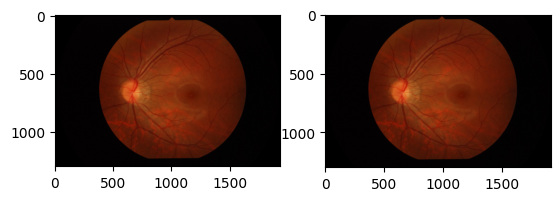

In [24]:
img_name = 'odir2019/ODIR-5K_Training_Dataset/900_left.jpg'
img = plt.imread(img_name)
fig,ax = plt.subplots(1,2)
ax[0].imshow(img)
ax[1].imshow(crop_nonzero(img))